In [1]:
!nvidia-smi

Wed Sep 17 05:18:14 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   64C    P0             38W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
! pip install diffusers

xformers to memory optimization

In [3]:
! pip install -q accelerate transformers  ftfy bitsandbytes gradio natsort safetensors xformers

## pipeline for image generation
- We can define with little effort a pipeline to use the stable diffusion model, through the stablediffusionpipeline

In [4]:
import torch

In [5]:
from diffusers import StableDiffusionPipeline

In [6]:
!pip install huggingface_hub

In [7]:
pipe = StableDiffusionPipeline.from_pretrained("CompVIs/stable-diffusion-v1-4", torch_dtype= torch.float16)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


In [8]:
pipe = pipe.to("cuda")

In [9]:
# optimize the use of memory
pipe.enable_attention_slicing()
pipe.enable_xformers_memory_efficient_attention()
"""Attention mechanisms in models like Stable Diffusion can be memory-intensive.
Attention slicing breaks down the attention computation into smaller chunks, processing them sequentially instead of all at once. This reduces the peak memory usage, allowing the model to run even if the full attention computation wouldn't fit in memory.
pipe.enable_xformers_memory_efficient_attention():
This line enables a memory-efficient attention mechanism provided by the xformers library (which you installed earlier).
xformers provides highly optimized implementations of attention that can significantly reduce memory consumption and often improve performance compared to the default attention implementation."""

"Attention mechanisms in models like Stable Diffusion can be memory-intensive.\nAttention slicing breaks down the attention computation into smaller chunks, processing them sequentially instead of all at once. This reduces the peak memory usage, allowing the model to run even if the full attention computation wouldn't fit in memory.\npipe.enable_xformers_memory_efficient_attention():\nThis line enables a memory-efficient attention mechanism provided by the xformers library (which you installed earlier).\nxformers provides highly optimized implementations of attention that can significantly reduce memory consumption and often improve performance compared to the default attention implementation."

### Creating the prompt

In [10]:
prompt = "an  black apple"

## generating the image

In [11]:
img = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

In [12]:
type(img)

PIL.Image.Image

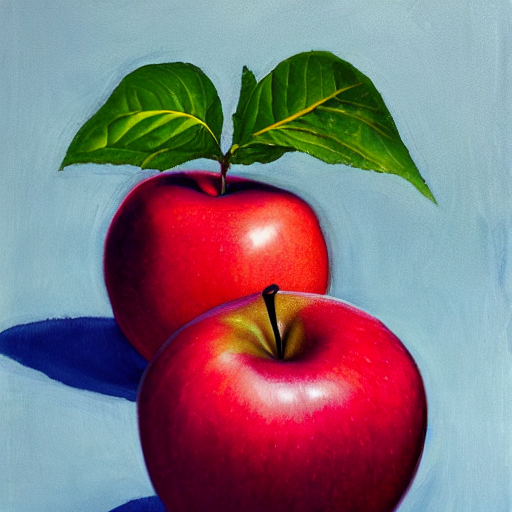

In [13]:
img

In [14]:
prompt = "photograph of black apple"

In [15]:
img = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

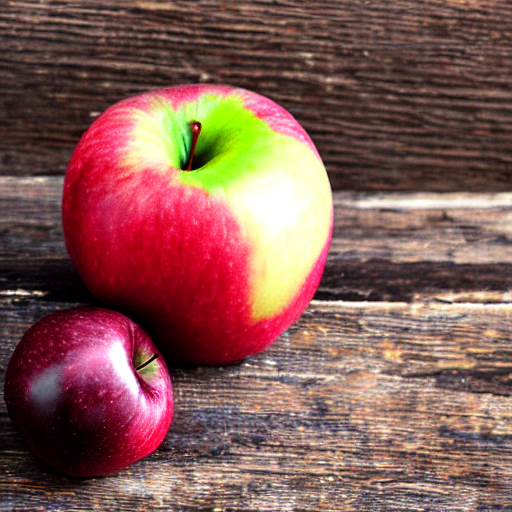

In [16]:
img

## saving the image

In [17]:
img.save('result.png')

  0%|          | 0/50 [00:00<?, ?it/s]

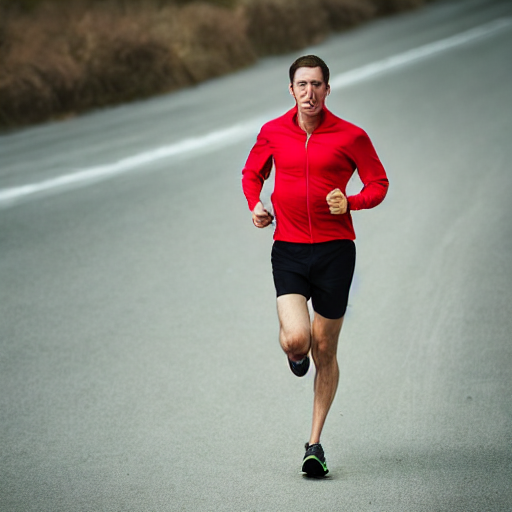

In [18]:
prompt = "single  man  running in  the race "
img = pipe(prompt).images[0]
img

In [19]:
img.size

(512, 512)

# Generating the multiple images
from PIL import Image: This line imports the Image class from the Pillow (PIL) library, which is a powerful image processing library in Python. You'll need this library to work with images.
def grid_img(imgs, rows=1, cols=3, scale=1):: This defines the function grid_img that takes a list of images (imgs) as input. It also has optional parameters for the number of rows and cols in the grid (defaulting to 1 row and 3 columns), and a scale factor (defaulting to 1).
assert len(imgs) == rows*cols: This line includes an assert statement. It checks if the total number of images in the input list (len(imgs)) is equal to the number of cells in the grid (rows * cols). If this condition is not met, the program will stop and raise an AssertionError, letting you know that the number of images doesn't match the grid dimensions you specified.
w, h = imgs[0].size: This line gets the width (w) and height (h) of the first image in the input list (imgs[0]). It assumes that all images in the list have the same dimensions.
grid = Image.new('RGB', size=(cols*w, rows*h)): This creates a new blank image using Image.new(). The new image is in 'RGB' mode and its size is calculated based on the number of columns and the width of individual images, and the number of rows and the height of individual images. This new image, stored in the grid variable, will serve as the canvas for arranging the input images.
grid_w, grid_h = grid.size: This line gets the width and height of the newly created blank grid image.


In [20]:
from PIL import Image

def grid_img(imgs, rows=1, cols=3, scale=1):
  # scale =1 means in original dimension
  # if scale is 0.7 then image dimension = 0.7*512 =width
  # 0.7*512 = height
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    w, h = int(w*scale), int(h*scale)
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size
    for i, img in enumerate(imgs):
      # as we going through the  list of image
        img = img.resize((w, h), Image.Resampling.LANCZOS)
        # Image.ANtIALIAS is use to preserve the apperance of image
        grid.paste(img, box=(i%cols*w, i//cols*h))
        #paste the image in grid
    return grid

  0%|          | 0/50 [00:00<?, ?it/s]

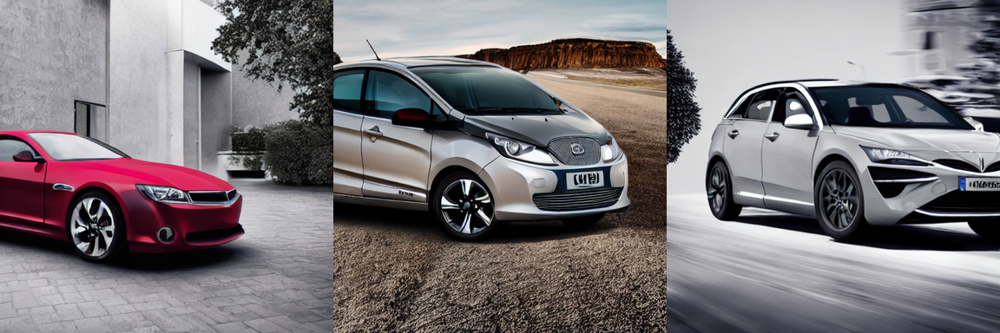

In [21]:
num_imgs = 3 # 3 news images
prompt = "photographcof an new car"
imgs = pipe(prompt , num_images_per_prompt=num_imgs).images
grid = grid_img(imgs, rows=1, cols=num_imgs, scale = 0.75)
grid

### Parameter seeds :
- The seed is number used to initialize the generation of random numbers. It is used to create the initial latent noise.
- By setting a seed, we can reproduce the results
Ai generate thes image from noise - it is like taking several colored pencils together and painting the littile dots in the sheet unitl finally generating the desired image

In [22]:
seed = 42
generator = torch.Generator("cuda").manual_seed(seed)

## Inference Steps:
- it is also known as denoising setps: default 50 loops of denoising and prompt

  0%|          | 0/20 [00:00<?, ?it/s]

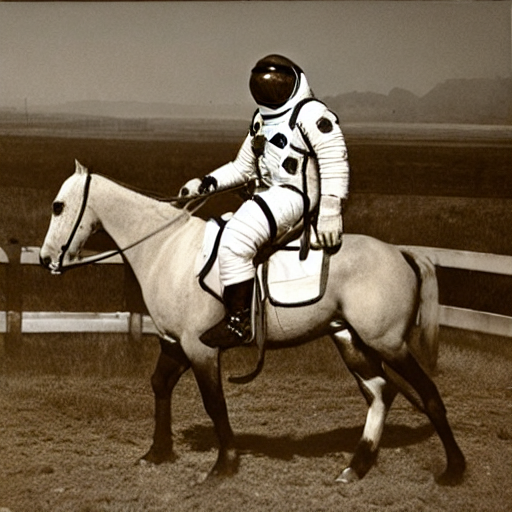

In [23]:
prompt = "a photograph of an astronaut riding a horse"
generator= torch.Generator("cuda").manual_seed(seed)
img = pipe(prompt, num_inference_steps=20, generator=generator).images[0]
img

In [24]:
import matplotlib.pyplot as plt

10


  0%|          | 0/10 [00:00<?, ?it/s]

20


  0%|          | 0/20 [00:00<?, ?it/s]

30


  0%|          | 0/30 [00:00<?, ?it/s]

40


  0%|          | 0/40 [00:00<?, ?it/s]

50


  0%|          | 0/50 [00:00<?, ?it/s]

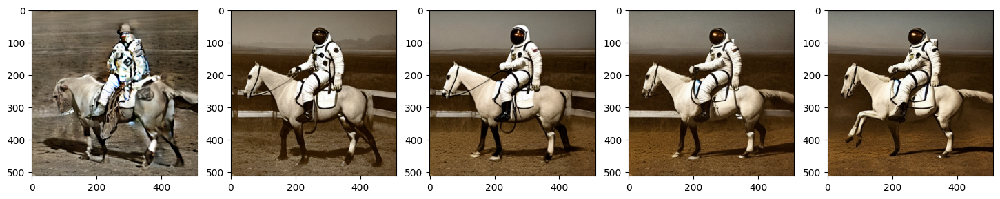

In [25]:
plt.figure(figsize=(18,8))
for i in range(1,6):
  n_steps = i*10
  print(n_steps)
  generator =torch.Generator("cuda").manual_seed(seed)
  img = pipe(prompt, num_inference_steps=n_steps, generator=generator).images[0]
  plt.subplot(1,5,i)
  plt.imshow(img)


### CFG: classfier
- to increase the adherence to the conditional prompt that guides the generation and quality of the image
- it takes cares of how much prompt will be taken inot account for conditioning the diffusion model
- take care the importance of the prompt given
- the best value is between 7 to 8.5. default is 7.5
- if values are too low or too high less realistic pictures come

  0%|          | 0/50 [00:00<?, ?it/s]

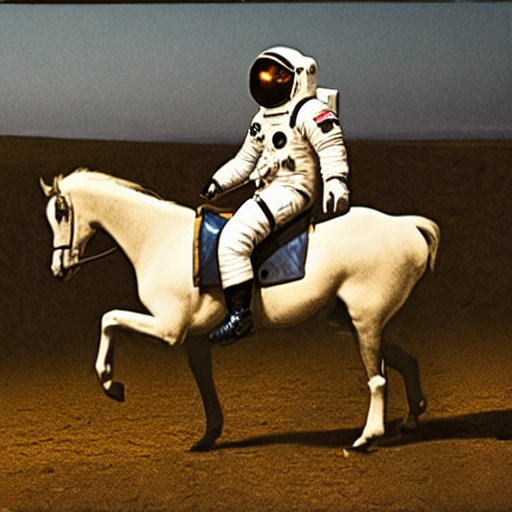

In [26]:
prompt = "a photograph of an astronaut riding a horse"
generator= torch.Generator("cuda").manual_seed(seed)
img = pipe(prompt,guidance_scale=10, num_inference_steps=50, generator=generator).images[0]
img

5


  0%|          | 0/50 [00:00<?, ?it/s]

6


  0%|          | 0/50 [00:00<?, ?it/s]

7


  0%|          | 0/50 [00:00<?, ?it/s]

8


  0%|          | 0/50 [00:00<?, ?it/s]

9


  0%|          | 0/50 [00:00<?, ?it/s]

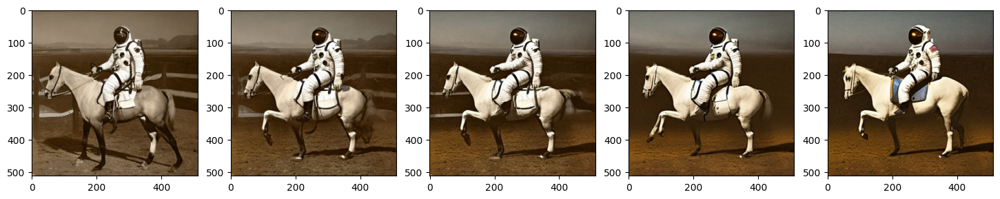

In [27]:
plt.figure(figsize=(18,8))
for i in range(1,6):
  n_guidance = i+4
  print(n_guidance)
  generator =torch.Generator("cuda").manual_seed(seed)
  img = pipe(prompt, guidance_scale=n_guidance, num_inference_steps=50, generator=generator).images[0]
  plt.subplot(1,5,i)
  plt.imshow(img)

# Image dimension
- default : 512*512

  0%|          | 0/50 [00:00<?, ?it/s]

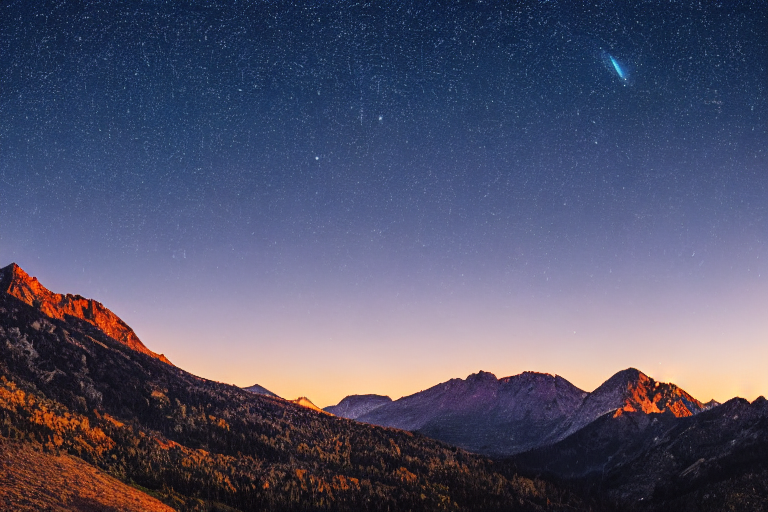

In [28]:
seed = 1
prompt = " photograph of a mountain landscape during sunset, stars in the sky"
generator = torch.Generator("cuda").manual_seed(seed)
h, w = 512, 768
img = pipe(prompt, height=h, width=w, generator=generator).images[0]
img

### Negative Prompts:
- During the text to image conditioning step, the prompt is converted into embedding vectors which will feed the U-Net noise predictor.
- There are two sets of embedding vectrs: one for the positive prompt and one for the negaative prompt.
- both the positive and negstive prompts have 77 tokens.

  0%|          | 0/50 [00:00<?, ?it/s]

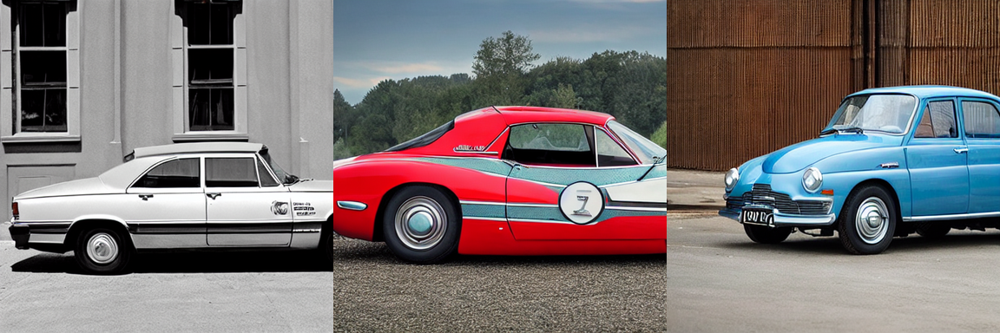

In [29]:
num_imgs=3
prompt = " Photograph of a car"
negative_prompt = "blurry and bw photo"
imgs = pipe(prompt, num_images_per_prompt=num_imgs, negative_prompt="blurry").images
grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.75)
grid

### SD uses Openclip now for text embedding
# SD XL : distillation techniques
also included
Lighting
Hyper are also there

# Fine tuned Models with specific Styles:
- Mo-di-diffusion(Modern Disney Style)

In [30]:
modi = StableDiffusionPipeline.from_pretrained("nitrosocke/mo-di-diffusion", torch_dtype = torch.float16)
modi = modi.to("cuda")
modi.enable_attention_slicing()
modi.enable_xformers_memory_efficient_attention()


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--nitrosocke--mo-di-diffusion/snapshots/e3106d24aa8c37bf856257daea2ae789eabc4d70/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--nitrosocke--mo-di-diffusion/snapshots/e3106d24aa8c37bf856257daea2ae789eabc4d70/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--nitrosocke--mo-di-diffusion/snapshots/e3106d24aa8c37bf856257daea2ae789eabc4d70/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--nitrosocke--mo-di-diffusion/snapshots/e3106d24aa8c37bf856257daea2ae789eabc4d70/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


  0%|          | 0/50 [00:00<?, ?it/s]

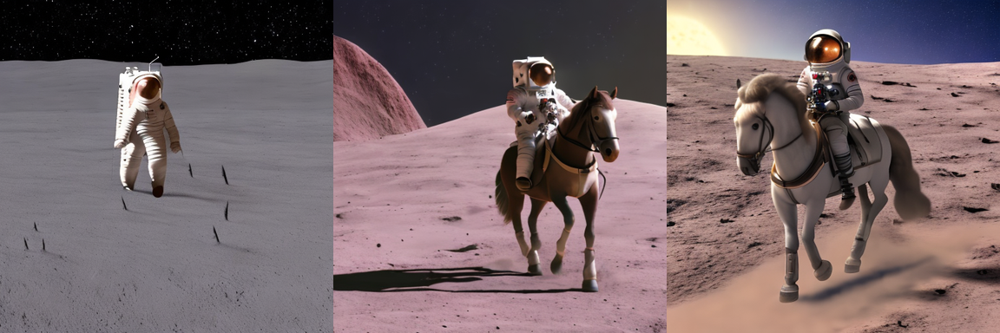

In [31]:
prompt = " a photo of an astronaut riding a horse on moon , modern disney style"
seed = 777
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 3 # Assuming you want 3 images in the grid
imgs = modi(prompt, num_images_per_prompt=num_imgs, generator=generator).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


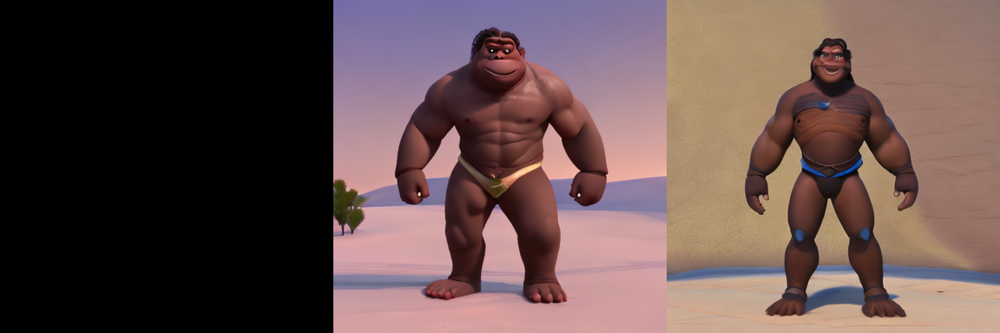

In [32]:
prompt = "creature assuming the body shape as mathematics epsilon,  modern disney style"
seed = 777
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 3 # Assuming you want 3 images in the grid
imgs = modi(prompt, num_images_per_prompt=num_imgs, generator=generator).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

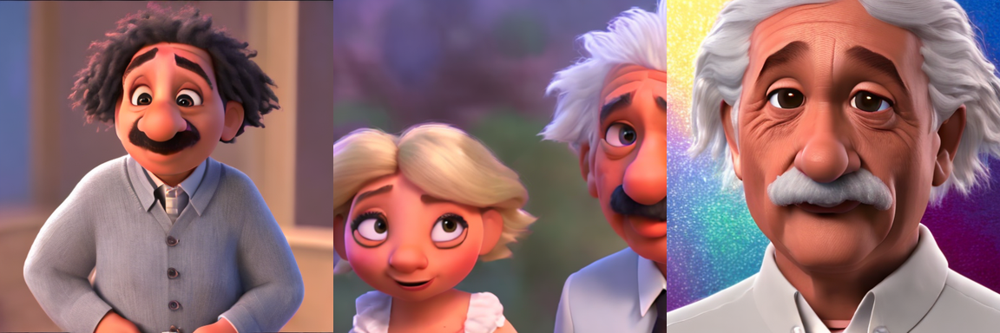

In [33]:
prompt = "albert einstein, modern disney style"
seed = 777
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 3 # Assuming you want 3 images in the grid
imgs = modi(prompt, num_images_per_prompt=num_imgs, generator=generator).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.75)
grid

### Changing the Scheduler(sampler)

In [34]:
sd15 = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype = torch.float16)
sd15 = sd15.to("cuda")
sd15.enable_attention_slicing()
sd15.enable_xformers_memory_efficient_attention()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [35]:
sd15.scheduler

PNDMScheduler {
  "_class_name": "PNDMScheduler",
  "_diffusers_version": "0.35.1",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "epsilon",
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "timestep_spacing": "leading",
  "trained_betas": null
}

In [36]:
seed = 42
prompt = "a photo of Mahadev"
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 1
imgs = sd15(prompt, num_images_per_prompt=1 ,generator=generator).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

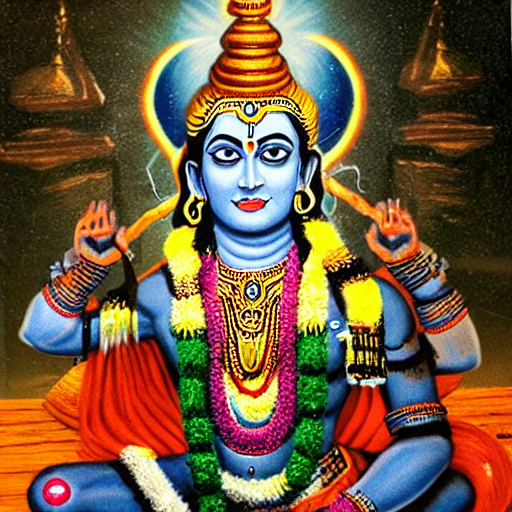

In [37]:
imgs

In [38]:
sd15.scheduler.compatibles

[diffusers.schedulers.scheduling_pndm.PNDMScheduler,
 diffusers.schedulers.scheduling_edm_euler.EDMEulerScheduler,
 diffusers.schedulers.scheduling_deis_multistep.DEISMultistepScheduler,
 diffusers.schedulers.scheduling_lms_discrete.LMSDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_singlestep.DPMSolverSinglestepScheduler,
 diffusers.utils.dummy_torch_and_torchsde_objects.DPMSolverSDEScheduler,
 diffusers.schedulers.scheduling_unipc_multistep.UniPCMultistepScheduler,
 diffusers.schedulers.scheduling_euler_ancestral_discrete.EulerAncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_k_dpm_2_ancestral_discrete.KDPM2AncestralDiscreteScheduler,
 diffusers.schedulers.scheduling_ddim.DDIMScheduler,
 diffusers.schedulers.scheduling_euler_discrete.EulerDiscreteScheduler,
 diffusers.schedulers.scheduling_ddpm.DDPMScheduler,
 diffusers.schedulers.scheduling_heun_discrete.HeunDiscreteScheduler,
 diffusers.schedulers.scheduling_dpmsolver_multistep.DPMSolverMultistepScheduler,


In [39]:
sd15.scheduler.config

FrozenDict([('num_train_timesteps', 1000),
            ('beta_start', 0.00085),
            ('beta_end', 0.012),
            ('beta_schedule', 'scaled_linear'),
            ('trained_betas', None),
            ('skip_prk_steps', True),
            ('set_alpha_to_one', False),
            ('prediction_type', 'epsilon'),
            ('timestep_spacing', 'leading'),
            ('steps_offset', 1),
            ('_use_default_values', ['timestep_spacing', 'prediction_type']),
            ('_class_name', 'PNDMScheduler'),
            ('_diffusers_version', '0.35.1'),
            ('clip_sample', False)])

In [40]:
from diffusers import DDIMScheduler
sd15.scheduler = DDIMScheduler.from_config(sd15.scheduler.config)

  0%|          | 0/50 [00:00<?, ?it/s]

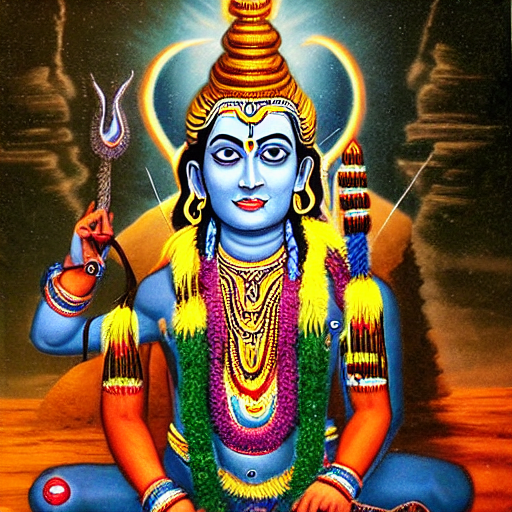

In [41]:
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 1
imgs = sd15(prompt, num_images_per_prompt=num_imgs ,generator=generator).images[0]
imgs
# there is the difference in the image

In [42]:
from diffusers import EulerAncestralDiscreteScheduler
sd15.scheduler = EulerAncestralDiscreteScheduler.from_config(sd15.scheduler.config)

  0%|          | 0/50 [00:00<?, ?it/s]

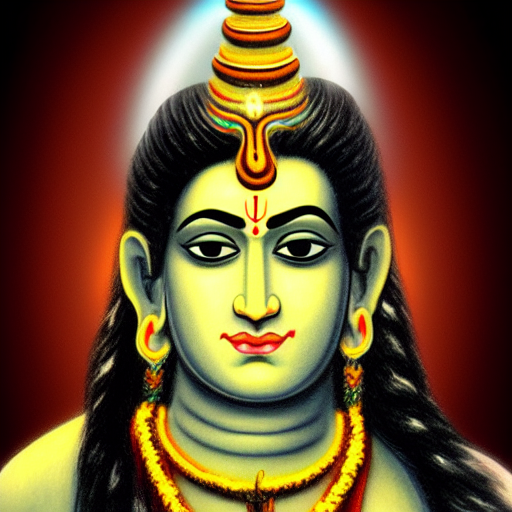

In [43]:
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 1
imgs = sd15(prompt, num_images_per_prompt=num_imgs ,generator=generator).images[0]
imgs

### Prompt Engineering

In [44]:
seed = 777

  0%|          | 0/50 [00:00<?, ?it/s]

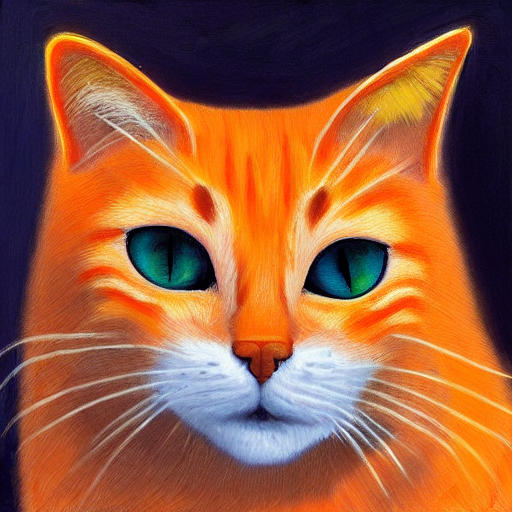

In [45]:
prompt = " an orange cat"
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 1
imgs = pipe(prompt, num_images_per_prompt=num_imgs ,generator=generator).images[0]
imgs

# Style Of Image

['Modernist orange cat reading a book in space', 'impressionist orange cat reading a book in space', 'realistic orange cat reading a book in space']


  0%|          | 0/50 [00:00<?, ?it/s]

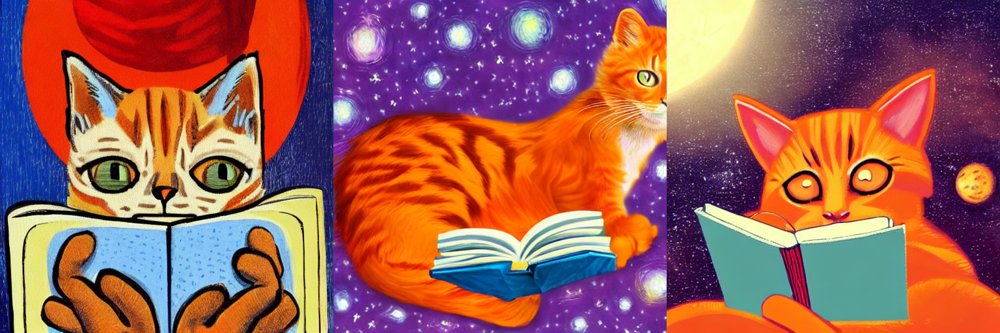

In [49]:
base = " orange cat reading a book in space"
m = ["Modernist", "impressionist", "realistic"]
prompt=[]
for x in m:
  prompt.append(x+base)
print(prompt)
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=1 ,generator=generator).images
grid = grid_img(imgs, rows=1, cols=3, scale=1)
grid

['by Van Gogh orange cat reading a book in space', 'By Monet orange cat reading a book in space', 'rby Da Vinci orange cat reading a book in space']


  0%|          | 0/50 [00:00<?, ?it/s]

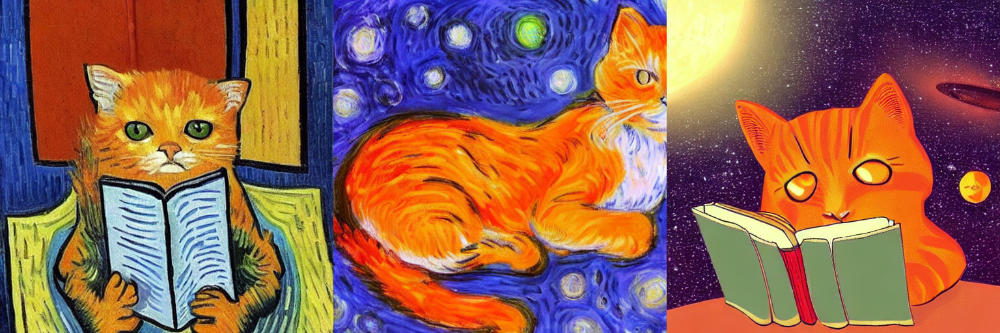

In [50]:
base = " orange cat reading a book in space"
m = ["by Van Gogh", "By Monet", "rby Da Vinci"]
prompt=[]
for x in m:
  prompt.append(x+base)
print(prompt)
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=1 ,generator=generator).images
grid = grid_img(imgs, rows=1, cols=3, scale=1)
grid

## Resolution

['unreal enginea futuristic city on an another planet at dawn', 'sharp focusa futuristic city on an another planet at dawn', 'vraya futuristic city on an another planet at dawn']


  0%|          | 0/50 [00:00<?, ?it/s]

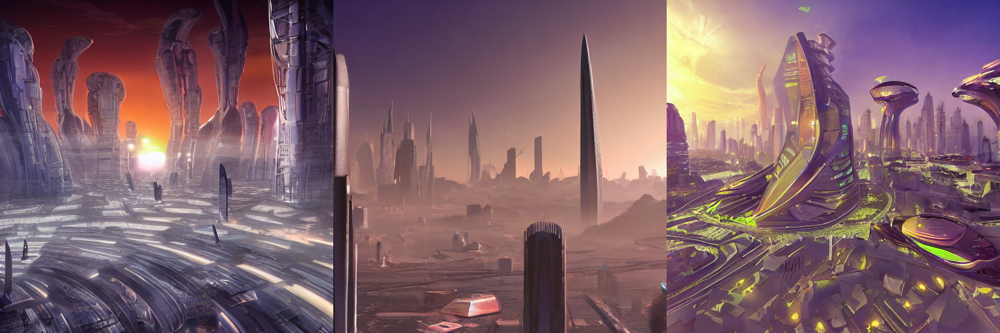

In [51]:
base = "a futuristic city on an another planet at dawn"

m = ["unreal engine", "sharp focus", "vray"]
prompt =[]
for x in m :
  prompt.append(x+base)
print(prompt)
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=1 ,generator=generator).images
grid = grid_img(imgs, rows=1, cols=3, scale=1)
grid

## Negative prompt

  0%|          | 0/50 [00:00<?, ?it/s]

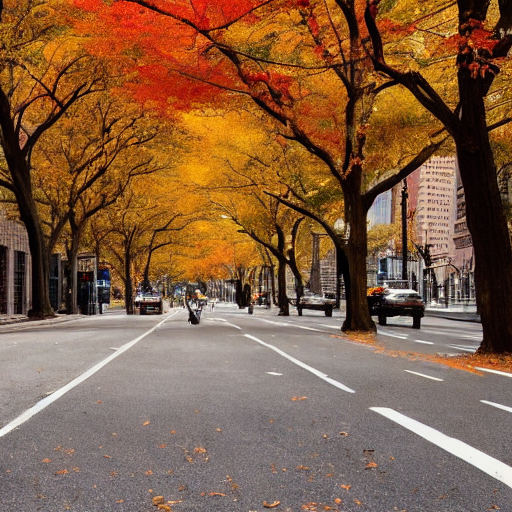

In [52]:
prompt = " photo of autumn in new york without cars."
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=1 ,generator=generator).images[0]
imgs


  0%|          | 0/50 [00:00<?, ?it/s]

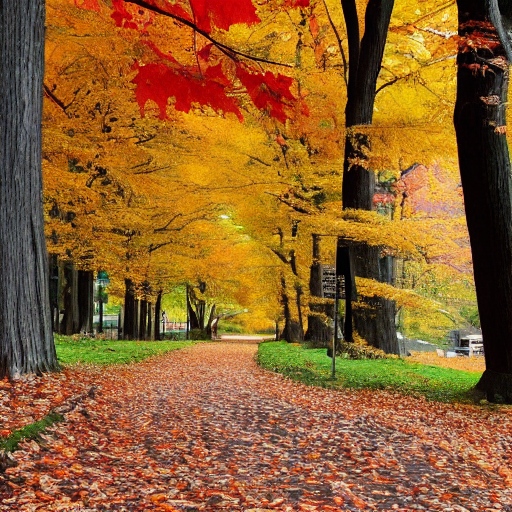

In [53]:
prompt = " photo of autumn in new york without cars."
neg_prompt= "cars and people"
generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, num_images_per_prompt=1 ,generator=generator, negative_prompt=neg_prompt).images[0]
imgs

  0%|          | 0/50 [00:00<?, ?it/s]

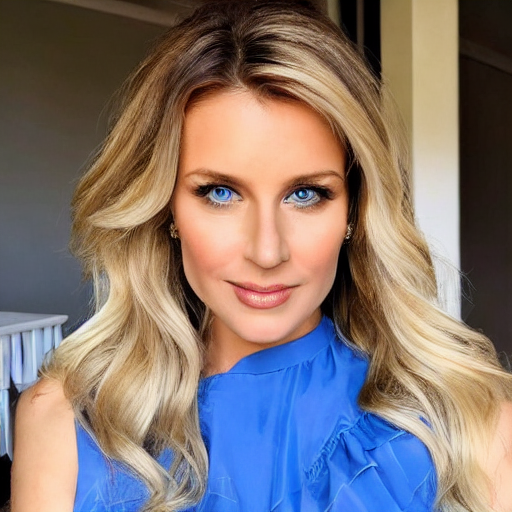

In [54]:
### Unibversal Negative Prompt
prompt = "a young beautiful woman, front face ,blonde hair, blue eyes, wearing a blue dress, natural light, cute face "
neg_prompt = "poorly drawn face , eyes, eye lashes"
generator = torch.Generator("cuda").manual_seed(seed)
img = pipe(prompt, negative_prompt=neg_prompt, generator=generator).images[0]
img

# Stable Diffusion Version 2:

In [55]:
sdv2 = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype= torch.float16)


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [56]:
from diffusers import EulerAncestralDiscreteScheduler
sdv2.scheduler= EulerAncestralDiscreteScheduler.from_config(sdv2.scheduler.config)
print(sdv2.scheduler)

sdv2 = sdv2.to("cuda")
sdv2.enable_attention_slicing()
sdv2.enable_xformers_memory_efficient_attention()

EulerAncestralDiscreteScheduler {
  "_class_name": "EulerAncestralDiscreteScheduler",
  "_diffusers_version": "0.35.1",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "v_prediction",
  "rescale_betas_zero_snr": false,
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "timestep_spacing": "linspace",
  "trained_betas": null
}



In [57]:
prompt = ["photo an orange cat wearing a hat", "a oil painting of an orange cat reading a book in the kitchen",
          "drawing of an orange cat readin g a book in the library"]
#neg_prompt= "bad anatomy, ugly, deformed, desfigured, distoted face, poorly drwan hands, poorly drawn face, poorly drawn"
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 3
imgs = sdv2(prompt, num_images_per_prompt=1 ,generator=generator,num_inference_steps=35).images
grid = grid_img(imgs, rows=1, cols=num_imgs, scale=1)
grid

Output hidden; open in https://colab.research.google.com to view.

  0%|          | 0/35 [00:00<?, ?it/s]

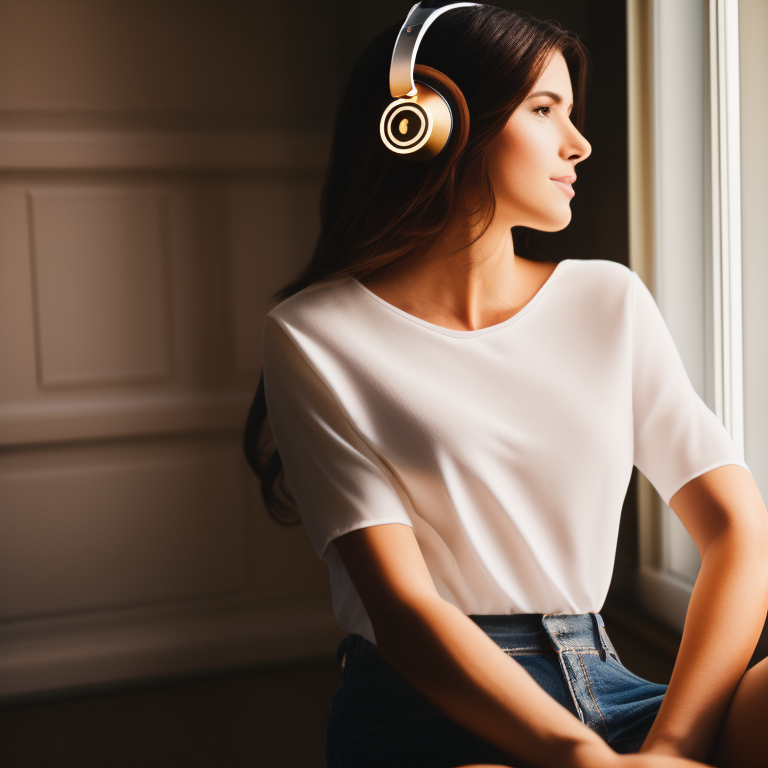

In [58]:
prompt = "photo of young woman sitting by window with headphones, realistic, golden hour, rim lighting"
neg_prompt = "bad anatimy, ugly, deformed, disfigured, distorted face, poorly drwn hands, proorly drwan face, poorly drawn"
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 1
imgs = sdv2(prompt, num_images_per_prompt=1 ,generator=generator,num_inference_steps=35, negative_prompt=neg_prompt).images
grid = grid_img(imgs, rows=1, cols=num_imgs, scale=1)
grid


# Generating Arts and Photographs :

  0%|          | 0/35 [00:00<?, ?it/s]

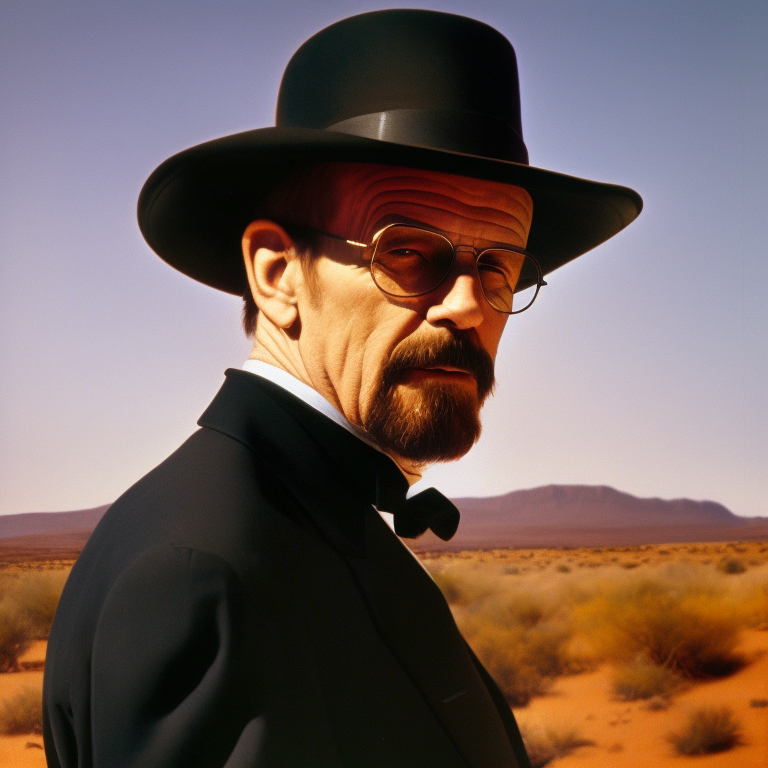

In [59]:
prompt = "oil painting walter white wearing a suit and black hat, by Alphonse Mucha , Face Portrait, in the dessert, realistic"
neg_prompt = "bad anatimy, ugly, deformed, disfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn"
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 1
imgs = sdv2(prompt, num_images_per_prompt=1 ,generator=generator,num_inference_steps=35, negative_prompt=neg_prompt).images
imgs
grid = grid_img(imgs, rows=1, cols=num_imgs, scale=1)
grid

  0%|          | 0/35 [00:00<?, ?it/s]

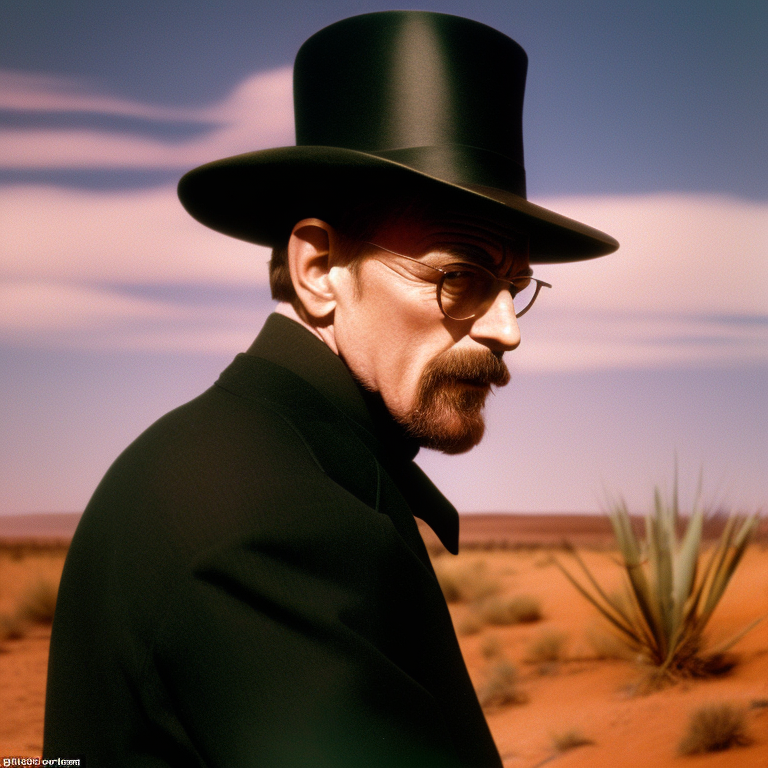

In [60]:
prompt = "phot walter white wearing a suit and black hat, by Alphonse Mucha , Face Portrait, in the dessert, realistic"
neg_prompt = "bad anatimy, ugly, deformed, disfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn"
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 1
imgs = sdv2(prompt, num_images_per_prompt=1 ,generator=generator,num_inference_steps=35, negative_prompt=neg_prompt).images
imgs
grid = grid_img(imgs, rows=1, cols=num_imgs, scale=1)
grid

# Generating Landscapes :

  0%|          | 0/35 [00:00<?, ?it/s]

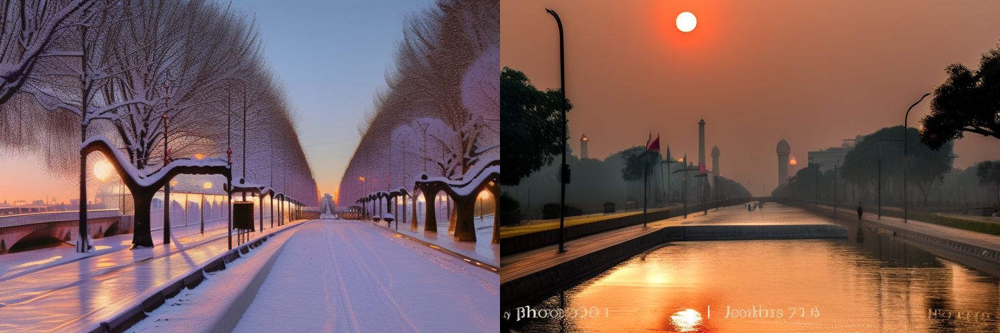

In [61]:
prompt = ["Photograph of snow in paris, realistic, landscape, sunset",
          " photograph of New Delhi, realistic, sunset, landscape"]
#neg_prompt = "bad anatimy, ugly, deformed, disfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn"
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 2
h, w = 512, 768
imgs = sdv2(prompt, height = h, width=w, num_images_per_prompt=1 ,generator=generator,num_inference_steps=35).images
imgs
grid = grid_img(imgs, rows=1, cols=num_imgs, scale=1)
grid

# Generating 3D Images :

  0%|          | 0/35 [00:00<?, ?it/s]

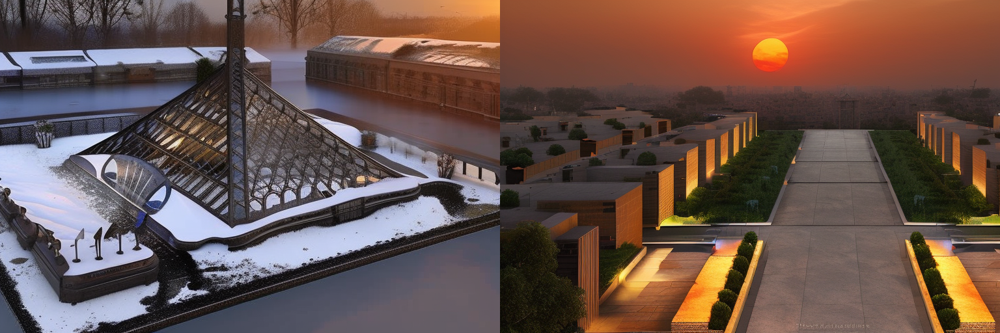

In [62]:
prompt = ["3d rendering of dirty snow in paris, realistic, landscape, sunset, 8k ",
          "3d rendering dirty of New Delhi, realistic, sunset, landscape, 8k"]
neg_prompt = [" overexposed, not centered, low resolution"]*len(prompt)
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 2
h, w = 512, 768
imgs = sdv2(prompt, height = h, width=w, negative_prompt=neg_prompt, num_images_per_prompt=1 ,generator=generator,num_inference_steps=35).images
imgs
grid = grid_img(imgs, rows=1, cols=num_imgs, scale=1)
grid

# Generating Drawings :

  0%|          | 0/35 [00:00<?, ?it/s]

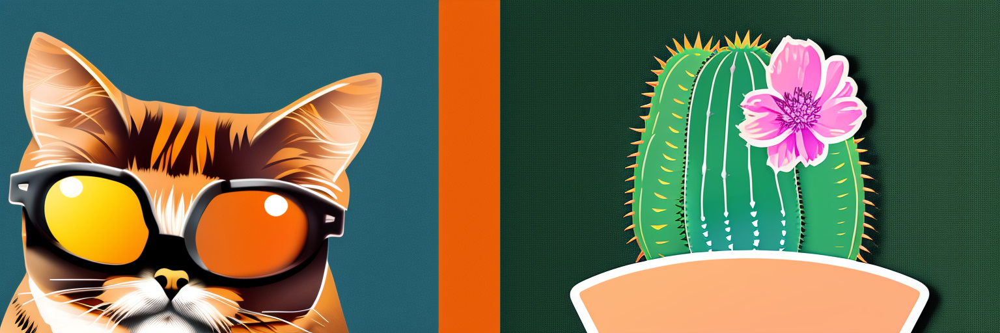

In [63]:
prompt = ["sticker design, an orange cat wearing sunglasses, cute vector, 8k, graphic design, beautiful design",
"cactus sticker, cute vector, 8k, graphic design"]
neg_prompt=["bad design, bad drawing, watermark"]*len(prompt)
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 2
h, w = 512, 768
imgs = sdv2(prompt, height = h, width=w, negative_prompt=neg_prompt, num_images_per_prompt=1 ,generator=generator,num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=1)
grid


# Generating Architecture :

  0%|          | 0/35 [00:00<?, ?it/s]

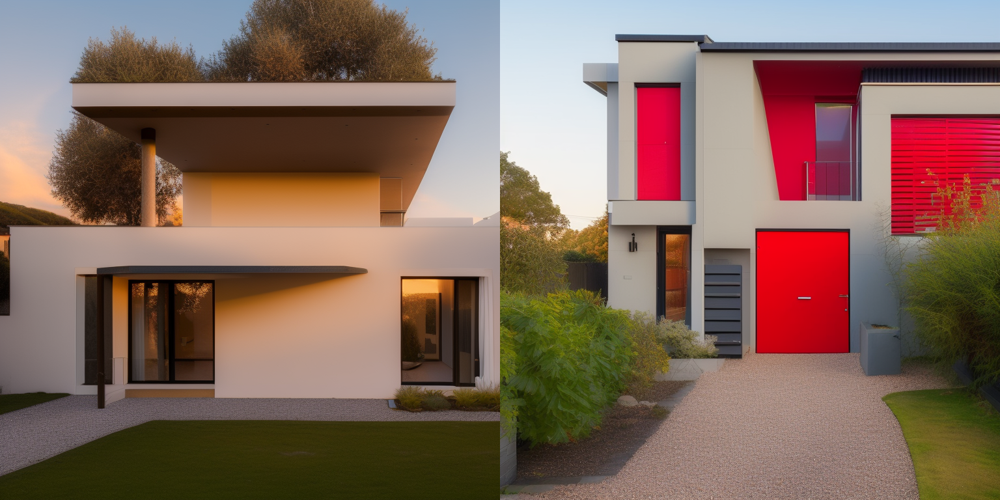

In [64]:
prompt = ["a professional photograph of an italian architectural modern home , soft render, sunset, golden hour",
          "a professional photograph photograph of a n modern house, red door, soft render, golden hour"]
neg_prompt=["watermark"]*len(prompt)
generator = torch.Generator("cuda").manual_seed(seed)
anything.safety_checker = None
num_imgs = 2

imgs = anything(prompt, negative_prompt=neg_prompt, num_images_per_prompt=1 ,generator=generator,num_inference_steps=35).images
grid= grid_img(imgs, rows =1, cols=num_imgs, scale=1)
grid

#

# Custom model for the improvement:
- Also called fine tuned models

In [71]:
from diffusers import StableDiffusionPipeline
import torch
seed= 777
anythingx= StableDiffusionPipeline.from_pretrained("cag/anything-v3-1", torch_dtype = torch.float16)
anythingx = anythingx.to("cuda")
anythingx.enable_attention_slicing()
anythingx.enable_xformers_memory_efficient_attention()

model_index.json:   0%|          | 0.00/511 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

safety_checker/pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

text_encoder/pytorch_model.bin:   0%|          | 0.00/492M [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/341 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/807 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/901 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--cag--anything-v3-1/snapshots/907b769ec43b228c9943b4df5ea193d6e885f840/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--cag--anything-v3-1/snapshots/907b769ec43b228c9943b4df5ea193d6e885f840/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--cag--anything-v3-1/snapshots/907b769ec43b228c9943b4df5ea193d6e885f840/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--cag--anything-v3-1/snapshots/907b769ec43b228c9943b4df5ea193d6e885f840/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.


  0%|          | 0/50 [00:00<?, ?it/s]

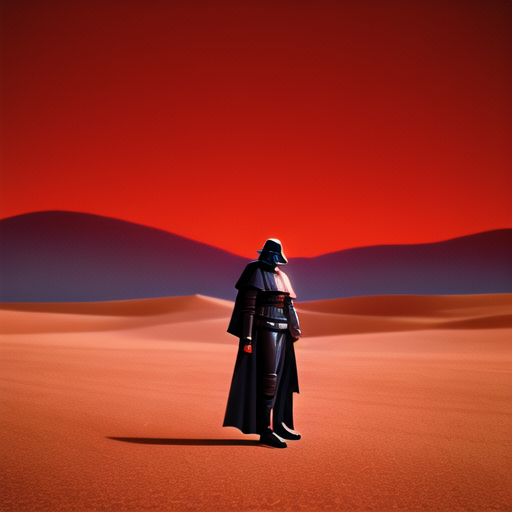

In [72]:
prompt = ["darth varde in the dessert medium shot, cinematic ,red tones, masterpiece, best quality, illustraiton, beautiful"]
neg_prompt=["bad drwaing, water mark, bad anatomy"]
generator = torch.Generator("cuda").manual_seed(seed)
num_imgs = 1
imgs = anythingx(prompt, num_images_per_prompt=1 ,generator=generator,negative_prompt=neg_prompt, guidance_scale =12, num_inference_steps=50).images
grid= grid_img(imgs, rows =1, cols=num_imgs, scale=1)
grid